## Dependances

In [1]:
import cv2 
import argparse
import sys
import os
import json
import time
import random
import datetime
import argparse
import numpy as np
from torch.utils.data import Dataset
from PIL import Image
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader

import datasets
import util.misc as utils
from models import build_model
import datasets.transforms as T
from torchvision.transforms import v2
from datasets import build_dataset
from engine import evaluate, train_one_epoch
from pathlib import Path
from torchsampler import ImbalancedDatasetSampler

# Local dep
project_dir = '/data/konrad/'
sys.path.insert(0, project_dir)

from helpers.datasets import CalfFaceDataset
from helpers.helpers import get_indices, load_face_data
from helpers.trainers import plot_metrics


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Utilitaires

In [2]:
class ImageDataset(Dataset):
    def __init__(self, dataset, transform=None):
        self.dataset = dataset
        self.transform = transform

    def __getitem__(self, index):
        row = self.dataset[index]
        img = row["image"]
        img_path = self.dataset.image_dir + '/' + self.dataset.data_frame.loc[index, "path"]
        
        target = {}
        target["file_name"] = [str(img_path)]
        target["image_label"] = torch.tensor([row["label"]], dtype=torch.int64)  # Set the target label as needed

        return img, target

    def __len__(self):
        return len(self.dataset)

    def get_labels(self):
        return self.dataset.data_frame["label"]

In [3]:
@torch.no_grad()
def predicted_class(output, topk=(1,)):
    query_logits = output['query_logits']
    batch_size = query_logits.size(0)
    
    maxk = min(max(topk), query_logits.size(1))
    _, pred = query_logits.topk(maxk, dim=1, largest=True, sorted=True)
    return pred

def get_class_name(number):
    modified_name = id2label[number]
    return modified_name

def SuperImposeHeatmap(attention, input_image):
    alpha=0.5
    avg_heatmap_resized = cv2.resize(attention, (input_image.shape[1], input_image.shape[0]), interpolation=cv2.INTER_CUBIC)
    avg_normalized_heatmap = (avg_heatmap_resized - np.min(avg_heatmap_resized)) / (np.max(avg_heatmap_resized) - np.min(avg_heatmap_resized))
    heatmap = (avg_normalized_heatmap * 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    heatmap = cv2.medianBlur(heatmap,15)
    heatmap =  cv2.GaussianBlur(heatmap, (15, 15), 0)
    result = (input_image *alpha  + heatmap * (1-alpha)).astype(np.uint8)
    return result


def visualization(args, image_path, query_index, attention_scores, encoder_output):

    attention_score = attention_scores[5, :, :, :, :] # sixth layer of the decoder
    attention_score_pred_query = attention_score[:, :, query_index, :] # query corresponding to predicted class 

    # Load and resize the original image
    input_image = cv2.imread(image_path)
    input_image = cv2.resize(input_image, (0, 0), fx=0.8, fy=0.8)

    # Create a subplot grid for the original image and visualizations
    num_heads = attention_score_pred_query.shape[1] + 1  
    rows = 1
    cols = num_heads // rows

    # Plot the original image
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
    axes[0].imshow(cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB))
    axes[0].axis('off')

    for head_index in range(attention_score_pred_query.shape[1]):
        heatmap_head = attention_score_pred_query[:, head_index, :].reshape(encoder_output.shape[2], encoder_output.shape[3]).detach().cpu().numpy()
        result = SuperImposeHeatmap(heatmap_head, input_image)

        if rows == 1 and cols == 1:
            ax = axes
        elif rows == 1:
            ax = axes[head_index + 1]
        elif cols == 1:
            ax = axes[head_index + 1]
        else:
            ax = axes[(head_index + 1) // cols, (head_index + 1) % cols]

        ax.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        ax.axis('off')

    plt.tight_layout()
    plt.show()



def load_model(args, model):
    checkpoint = torch.load(args.resume, map_location='cpu')
    model.load_state_dict(checkpoint['model'])
    return model


In [4]:
def get_args_parser(training = False):
    parser = argparse.ArgumentParser('Set transformer detector', add_help=False)
    parser.add_argument('--batch_size', default=12, type=int)

    if training:
        parser.add_argument('--lr', default=5.00e-5, type=float) 
        parser.add_argument('--lr_backbone', default=0, type=float) 
        parser.add_argument('--min_lr', default=1.00e-6, type=float) 
        parser.add_argument('--weight_decay', default=1e-6, type=float)
        parser.add_argument('--epochs', default=10, type=int) 
        parser.add_argument('--lr_drop', default=80, type=int) 
        parser.add_argument('--lr_scheduler', default="StepLR", type=str, choices=["StepLR", "CosineAnnealingLR"])
        parser.add_argument('--clip_max_norm', default=0.1, type=float,
                            help='gradient clipping max norm')

    # * Backbone
    parser.add_argument('--backbone', default='resnet50', type=str,
                        help="Name of the convolutional backbone to use")
    parser.add_argument('--dilation', action='store_true',
                        help="If true, we replace stride with dilation in the last convolutional block (DC5)")
    parser.add_argument('--position_embedding', default='sine', type=str, choices=('sine', 'learned'),
                        help="Type of positional embedding to use on top of the image features")
    if training:
        parser.add_argument('--finetune', default='intr_checkpoint_cub_detr_r50.pth',
                        help='resume from checkpoint')
    else:
        parser.add_argument('--resume', default=ROOT_DIR + '/image_classification/repos/intr/output/calf_face/output_sub/checkpoint.pth',
                        help='resume from checkpoint')
    
    # * Transformer
    parser.add_argument('--enc_layers', default=6, type=int,
                        help="Number of encoding layers in the transformer")
    parser.add_argument('--dec_layers', default=6, type=int,
                        help="Number of decoding layers in the transformer")
    parser.add_argument('--dim_feedforward', default=2048, type=int,
                        help="Intermediate size of the feedforward layers in the transformer blocks")
    parser.add_argument('--hidden_dim', default=256, type=int,
                        help="Size of the embeddings (dimension of the transformer)")
    parser.add_argument('--dropout', default=0.1, type=float,
                        help="Dropout applied in the transformer") #default=0.1
    parser.add_argument('--nheads', default=8, type=int,
                        help="Number of attention heads inside the transformer's attentions")
    parser.add_argument('--num_queries', default=3, type=int,
                        help="Number of query slots")
    parser.add_argument('--pre_norm', action='store_true')

    # # * Dataset parameters
    parser.add_argument('--dataset_name', default='calf_face') 
    parser.add_argument('--output_dir', default='output',
                        help='path where to save, empty for no saving')
    parser.add_argument('--output_sub_dir', default='output_sub')

    # * Device parameters
    parser.add_argument('--device', default='cuda',
                        help='device to use for training / testing')
    
    return parser

## Setup

In [6]:
ROOT_DIR = "/data/konrad"
DATA_FILE = '/data/konrad/datasets/CompleteDatasetNormalFace/Face_annotations.csv'
IMAGE_DIR = "/data/konrad/datasets/CompleteDatasetNormalFace"

df, labels, label2id, id2label = load_face_data(DATA_FILE, IMAGE_DIR)

In [7]:
train_indices, test_indices, valid_indices = get_indices(len(df))
IMAGE_SIZE = 224

data_mean_std = {
    "cub": (
        torch.tensor([0.485, 0.456, 0.406]),
        torch.tensor([0.229, 0.224, 0.225]),
    ),
}
mean, std = data_mean_std["cub"]

train_transform = v2.Compose([
    v2.Resize(size=(IMAGE_SIZE, IMAGE_SIZE)),
    v2.AutoAugment(v2.AutoAugmentPolicy.IMAGENET),
    v2.ToDtype(torch.float32, scale=True),
    v2.Normalize(mean=mean, std=mean),
])
train_dataset = CalfFaceDataset(df.iloc[train_indices, :].reset_index(drop=True), IMAGE_DIR, transform=train_transform)

test_transform = v2.Compose([
    v2.Resize(size=(IMAGE_SIZE, IMAGE_SIZE)),
    v2.ToDtype(torch.float32, scale=True),
    v2.Normalize(mean=mean, std=std),
])
test_dataset = CalfFaceDataset(df.iloc[test_indices, :].reset_index(drop=True), IMAGE_DIR, transform=test_transform)
valid_dataset = CalfFaceDataset(df.iloc[valid_indices, :].reset_index(drop=True), IMAGE_DIR, transform=test_transform)

# Data loaders
batch_size = 8
train_loader = DataLoader(ImageDataset(train_dataset), sampler=ImbalancedDatasetSampler(ImageDataset(train_dataset)), batch_size=batch_size)
test_loader = DataLoader(ImageDataset(test_dataset), batch_size=batch_size * 2, shuffle=False)


# dl = valid_loader.dataset.data_frame
# class_counts = dl['label'].value_counts()

# # Plot the distribution
# plt.figure(figsize=(8, 6))
# class_counts.plot(kind='bar')
# plt.title('Distribution of Classes in Validation set')
# plt.xlabel('Class')
# plt.ylabel('Count')
# plt.xticks(rotation=45)
# plt.grid(axis='y', linestyle='--', alpha=0.7)
# plt.show()

## Training

In [8]:
parser = argparse.ArgumentParser('INTR training and evaluation script', parents=[get_args_parser(training=T)])
args = parser.parse_args([])
if args.output_dir:
    Path(args.output_dir).mkdir(parents=True, exist_ok=True)


seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

model, criterion = build_model(args)
model.to(device)
model_without_ddp = model

n_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print('number of params:', n_parameters)

param_dicts = [
    {"params": [p for n, p in model_without_ddp.named_parameters() if "backbone" not in n and p.requires_grad]},
    {
        "params": [p for n, p in model_without_ddp.named_parameters() if "backbone" in n and p.requires_grad],
        "lr": args.lr_backbone,
    },
]


if args.lr_scheduler=="StepLR":
    optimizer = torch.optim.AdamW(param_dicts, lr=args.lr,
                                  weight_decay=args.weight_decay)
    lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_drop)

if args.lr_scheduler=="CosineAnnealingLR":
    optimizer = torch.optim.AdamW(param_dicts, lr=args.lr, 
                                weight_decay=args.weight_decay)
    lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=args.epochs, eta_min=args.min_lr)

dataset_train = ImageDataset(train_dataset)
dataset_val = ImageDataset(test_dataset)

sampler_train = torch.utils.data.RandomSampler(dataset_train)
sampler_val = torch.utils.data.SequentialSampler(dataset_val)

batch_sampler_train = torch.utils.data.BatchSampler(
    sampler_train, args.batch_size, drop_last=True)

data_loader_train = DataLoader(dataset_train, batch_sampler=batch_sampler_train,
                               collate_fn=utils.collate_fn)
data_loader_val = DataLoader(dataset_val, args.batch_size, sampler=sampler_val,
                             drop_last=False, collate_fn=utils.collate_fn)

#   We create output directories to store results
output_dir = Path(args.output_dir)
if not os.path.exists(os.path.join(output_dir, args.dataset_name)):
    os.makedirs(os.path.join(output_dir, args.dataset_name), exist_ok=True)
if not os.path.exists(os.path.join(output_dir, args.dataset_name, args.output_sub_dir)):
    os.makedirs(os.path.join(output_dir, args.dataset_name, args.output_sub_dir), exist_ok=True)

if args.finetune:
    if args.finetune.startswith('https'):
        checkpoint = torch.hub.load_state_dict_from_url(
            args.finetune, map_location='cpu', check_hash=True)
    else:
        checkpoint = torch.load(args.finetune, map_location='cpu')
    state_dict = checkpoint['model']

    existing_num_queries = state_dict['query_embed.weight'].shape[0]

    if args.num_queries<existing_num_queries:
        new_query_embeds = state_dict['query_embed.weight'][:args.num_queries, :]
        state_dict['query_embed.weight'] = new_query_embeds
    
    model_without_ddp.load_state_dict(state_dict)

    for param in model_without_ddp.parameters():
        param.requires_grad = True
    model_without_ddp.to(device)

train_losses, train_accuracies, train_recalls, train_f1_scores = [], [], [], []
valid_losses, valid_accuracies, valid_recalls, valid_f1_scores = [], [], [], []

print("Start training")
start_time = time.time()
for epoch in range(args.epochs):

    train_stats = train_one_epoch(
        model, criterion, data_loader_train, optimizer, device, epoch,
        args.clip_max_norm)
    print("\n")

    lr_scheduler.step()
    if args.output_dir:
        checkpoint_paths = [output_dir / args.dataset_name / args.output_sub_dir/ 'checkpoint.pth']

        if (epoch + 1) % args.lr_drop == 0 or (epoch + 1)==args.epochs:
            checkpoint_paths.append(output_dir / args.dataset_name / args.output_sub_dir / f'checkpoint{epoch:04}.pth')
        for checkpoint_path in checkpoint_paths:
            utils.save_on_master({
                'model': model_without_ddp.state_dict(),
                'optimizer': optimizer.state_dict(),
                'lr_scheduler': lr_scheduler.state_dict(),
                'epoch': epoch,
                'args': args,
            }, checkpoint_path)

    test_stats = evaluate(
        model, criterion,  data_loader_val, device, args.output_dir
    )

    train_losses.append(train_stats["loss"])
    train_accuracies.append(train_stats["precision"])
    train_recalls.append(train_stats["recall"])
    train_f1_scores.append(train_stats["f1"])

    valid_losses.append(test_stats["loss"])
    valid_accuracies.append(test_stats["precision"])
    valid_recalls.append(test_stats["recall"])
    valid_f1_scores.append(test_stats["f1"])

    print("-" * 30)
    print("\n\n")

total_time = time.time() - start_time
total_time_str = str(datetime.timedelta(seconds=int(total_time)))
print('Training time {}'.format(total_time_str))

/data/konrad/jupiter_env/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/data/konrad/jupiter_env/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


number of params: 17889025
Start training
Epoch: [0]  [ 0/12]  eta: 0:00:22  lr: 0.000050  loss: 1.5749 (1.5749)  acc1: 41.6667 (41.6667)  f1: 0.4333 (0.4333)  precision: 0.6389 (0.6389)  recall: 0.4167 (0.4167)  time: 1.8968  data: 0.3420  max mem: 921
Epoch: [0]  [10/12]  eta: 0:00:01  lr: 0.000050  loss: 1.1726 (1.2681)  acc1: 41.6667 (35.6061)  f1: 0.4067 (0.3489)  precision: 0.4306 (0.4190)  recall: 0.4167 (0.3561)  time: 0.5262  data: 0.3430  max mem: 1101
Epoch: [0]  [11/12]  eta: 0:00:00  lr: 0.000050  loss: 1.1597 (1.2477)  acc1: 41.6667 (36.8056)  f1: 0.4067 (0.3639)  precision: 0.4306 (0.4333)  recall: 0.4167 (0.3681)  time: 0.5148  data: 0.3426  max mem: 1101
Epoch: [0] Total time: 0:00:06 (0.5149 s / it)
Averaged stats: lr: 0.000050  loss: 1.1597 (1.2477)  acc1: 41.6667 (36.8056)  f1: 0.4067 (0.3639)  precision: 0.4306 (0.4333)  recall: 0.4167 (0.3681)


Test:  [0/2]  eta: 0:00:00  loss: 1.1399 (1.1399)  acc1: 25.0000 (25.0000)  f1: 0.1154 (0.1154)  precision: 0.0750 (0.07

/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [1]  [10/12]  eta: 0:00:00  lr: 0.000050  loss: 1.1256 (1.1289)  acc1: 33.3333 (34.0909)  f1: 0.3413 (0.3523)  precision: 0.3750 (0.3887)  recall: 0.3333 (0.3409)  time: 0.3894  data: 0.3388  max mem: 1102


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [1]  [11/12]  eta: 0:00:00  lr: 0.000050  loss: 1.1242 (1.1254)  acc1: 33.3333 (34.7222)  f1: 0.3125 (0.3490)  precision: 0.3413 (0.3771)  recall: 0.3333 (0.3472)  time: 0.3879  data: 0.3373  max mem: 1102
Epoch: [1] Total time: 0:00:04 (0.3881 s / it)
Averaged stats: lr: 0.000050  loss: 1.1242 (1.1254)  acc1: 33.3333 (34.7222)  f1: 0.3125 (0.3490)  precision: 0.3413 (0.3771)  recall: 0.3333 (0.3472)




/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test:  [0/2]  eta: 0:00:00  loss: 1.2173 (1.2173)  acc1: 25.0000 (25.0000)  f1: 0.1000 (0.1000)  precision: 0.0625 (0.0625)  recall: 0.2500 (0.2500)  time: 0.3510  data: 0.3341  max mem: 1102


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test:  [1/2]  eta: 0:00:00  loss: 0.9995 (1.1084)  acc1: 25.0000 (41.0714)  f1: 0.1000 (0.2881)  precision: 0.0625 (0.2812)  recall: 0.2500 (0.4107)  time: 0.2859  data: 0.2693  max mem: 1102
Test: Total time: 0:00:00 (0.2865 s / it)
Averaged stats: loss: 0.9995 (1.1084)  acc1: 25.0000 (41.0714)  f1: 0.1000 (0.2881)  precision: 0.0625 (0.2812)  recall: 0.2500 (0.4107)
------------------------------



Epoch: [2]  [ 0/12]  eta: 0:00:04  lr: 0.000050  loss: 0.9642 (0.9642)  acc1: 50.0000 (50.0000)  f1: 0.5333 (0.5333)  precision: 0.5714 (0.5714)  recall: 0.5000 (0.5000)  time: 0.3816  data: 0.3322  max mem: 1102


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/k

Epoch: [2]  [10/12]  eta: 0:00:00  lr: 0.000050  loss: 1.1115 (1.0926)  acc1: 41.6667 (40.9091)  f1: 0.3333 (0.3608)  precision: 0.3182 (0.3697)  recall: 0.4167 (0.4091)  time: 0.3860  data: 0.3371  max mem: 1102
Epoch: [2]  [11/12]  eta: 0:00:00  lr: 0.000050  loss: 1.0264 (1.0735)  acc1: 41.6667 (41.6667)  f1: 0.3333 (0.3691)  precision: 0.3182 (0.3821)  recall: 0.4167 (0.4167)  time: 0.3858  data: 0.3371  max mem: 1102
Epoch: [2] Total time: 0:00:04 (0.3860 s / it)
Averaged stats: lr: 0.000050  loss: 1.0264 (1.0735)  acc1: 41.6667 (41.6667)  f1: 0.3333 (0.3691)  precision: 0.3182 (0.3821)  recall: 0.4167 (0.4167)




/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test:  [0/2]  eta: 0:00:00  loss: 1.3948 (1.3948)  acc1: 25.0000 (25.0000)  f1: 0.1000 (0.1000)  precision: 0.0625 (0.0625)  recall: 0.2500 (0.2500)  time: 0.3470  data: 0.3299  max mem: 1102


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test:  [1/2]  eta: 0:00:00  loss: 1.0453 (1.2201)  acc1: 25.0000 (41.0714)  f1: 0.1000 (0.2881)  precision: 0.0625 (0.2812)  recall: 0.2500 (0.4107)  time: 0.2845  data: 0.2679  max mem: 1102
Test: Total time: 0:00:00 (0.2851 s / it)
Averaged stats: loss: 1.0453 (1.2201)  acc1: 25.0000 (41.0714)  f1: 0.1000 (0.2881)  precision: 0.0625 (0.2812)  recall: 0.2500 (0.4107)
------------------------------





/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [3]  [ 0/12]  eta: 0:00:04  lr: 0.000050  loss: 0.9542 (0.9542)  acc1: 58.3333 (58.3333)  f1: 0.5229 (0.5229)  precision: 0.5167 (0.5167)  recall: 0.5833 (0.5833)  time: 0.3891  data: 0.3422  max mem: 1102


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [3]  [10/12]  eta: 0:00:00  lr: 0.000050  loss: 1.0833 (1.0783)  acc1: 50.0000 (44.6970)  f1: 0.4033 (0.4060)  precision: 0.5625 (0.5095)  recall: 0.5000 (0.4470)  time: 0.3860  data: 0.3388  max mem: 1104
Epoch: [3]  [11/12]  eta: 0:00:00  lr: 0.000050  loss: 1.0833 (1.0853)  acc1: 41.6667 (43.0556)  f1: 0.3611 (0.3940)  precision: 0.5167 (0.4925)  recall: 0.4167 (0.4306)  time: 0.3859  data: 0.3386  max mem: 1104
Epoch: [3] Total time: 0:00:04 (0.3860 s / it)
Averaged stats: lr: 0.000050  loss: 1.0833 (1.0853)  acc1: 41.6667 (43.0556)  f1: 0.3611 (0.3940)  precision: 0.5167 (0.4925)  recall: 0.4167 (0.4306)




/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test:  [0/2]  eta: 0:00:00  loss: 1.4809 (1.4809)  acc1: 25.0000 (25.0000)  f1: 0.1000 (0.1000)  precision: 0.0625 (0.0625)  recall: 0.2500 (0.2500)  time: 0.3465  data: 0.3295  max mem: 1104


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test:  [1/2]  eta: 0:00:00  loss: 1.0383 (1.2596)  acc1: 25.0000 (41.0714)  f1: 0.1000 (0.2881)  precision: 0.0625 (0.2812)  recall: 0.2500 (0.4107)  time: 0.2842  data: 0.2675  max mem: 1104
Test: Total time: 0:00:00 (0.2846 s / it)
Averaged stats: loss: 1.0383 (1.2596)  acc1: 25.0000 (41.0714)  f1: 0.1000 (0.2881)  precision: 0.0625 (0.2812)  recall: 0.2500 (0.4107)
------------------------------



Epoch: [4]  [ 0/12]  eta: 0:00:04  lr: 0.000050  loss: 1.0886 (1.0886)  acc1: 33.3333 (33.3333)  f1: 0.2872 (0.2872)  precision: 0.4444 (0.4444)  recall: 0.3333 (0.3333)  time: 0.3878  data: 0.3407  max mem: 1104


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [4]  [10/12]  eta: 0:00:00  lr: 0.000050  loss: 1.0050 (0.9795)  acc1: 41.6667 (46.9697)  f1: 0.3403 (0.4349)  precision: 0.4444 (0.4632)  recall: 0.4167 (0.4697)  time: 0.3875  data: 0.3398  max mem: 1104


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [4]  [11/12]  eta: 0:00:00  lr: 0.000050  loss: 1.0050 (1.0328)  acc1: 41.6667 (47.2222)  f1: 0.3403 (0.4297)  precision: 0.3667 (0.4508)  recall: 0.4167 (0.4722)  time: 0.3868  data: 0.3389  max mem: 1104
Epoch: [4] Total time: 0:00:04 (0.3870 s / it)
Averaged stats: lr: 0.000050  loss: 1.0050 (1.0328)  acc1: 41.6667 (47.2222)  f1: 0.3403 (0.4297)  precision: 0.3667 (0.4508)  recall: 0.4167 (0.4722)




/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test:  [0/2]  eta: 0:00:00  loss: 1.7880 (1.7880)  acc1: 25.0000 (25.0000)  f1: 0.1071 (0.1071)  precision: 0.0682 (0.0682)  recall: 0.2500 (0.2500)  time: 0.3487  data: 0.3315  max mem: 1104


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test:  [1/2]  eta: 0:00:00  loss: 1.1023 (1.4451)  acc1: 25.0000 (41.0714)  f1: 0.1071 (0.2917)  precision: 0.0682 (0.2841)  recall: 0.2500 (0.4107)  time: 0.2856  data: 0.2689  max mem: 1104
Test: Total time: 0:00:00 (0.2862 s / it)
Averaged stats: loss: 1.1023 (1.4451)  acc1: 25.0000 (41.0714)  f1: 0.1071 (0.2917)  precision: 0.0682 (0.2841)  recall: 0.2500 (0.4107)
------------------------------





/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [5]  [ 0/12]  eta: 0:00:04  lr: 0.000050  loss: 1.1892 (1.1892)  acc1: 41.6667 (41.6667)  f1: 0.2718 (0.2718)  precision: 0.2037 (0.2037)  recall: 0.4167 (0.4167)  time: 0.3778  data: 0.3277  max mem: 1104
Epoch: [5]  [10/12]  eta: 0:00:00  lr: 0.000050  loss: 0.9027 (0.9401)  acc1: 50.0000 (48.4848)  f1: 0.4929 (0.4519)  precision: 0.5000 (0.4798)  recall: 0.5000 (0.4848)  time: 0.3887  data: 0.3392  max mem: 1104


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [5]  [11/12]  eta: 0:00:00  lr: 0.000050  loss: 0.9027 (0.9669)  acc1: 50.0000 (47.9167)  f1: 0.4912 (0.4374)  precision: 0.4940 (0.4572)  recall: 0.5000 (0.4792)  time: 0.3887  data: 0.3392  max mem: 1104
Epoch: [5] Total time: 0:00:04 (0.3889 s / it)
Averaged stats: lr: 0.000050  loss: 0.9027 (0.9669)  acc1: 50.0000 (47.9167)  f1: 0.4912 (0.4374)  precision: 0.4940 (0.4572)  recall: 0.5000 (0.4792)


Test:  [0/2]  eta: 0:00:00  loss: 2.1424 (2.1424)  acc1: 8.3333 (8.3333)  f1: 0.0455 (0.0455)  precision: 0.0312 (0.0312)  recall: 0.0833 (0.0833)  time: 0.3458  data: 0.3288  max mem: 1104


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Test:  [1/2]  eta: 0:00:00  loss: 1.0569 (1.5997)  acc1: 8.3333 (32.7381)  f1: 0.0455 (0.2549)  precision: 0.0312 (0.2156)  recall: 0.0833 (0.3274)  time: 0.2848  data: 0.2681  max mem: 1104
Test: Total time: 0:00:00 (0.2853 s / it)
Averaged stats: loss: 1.0569 (1.5997)  acc1: 8.3333 (32.7381)  f1: 0.0455 (0.2549)  precision: 0.0312 (0.2156)  recall: 0.0833 (0.3274)
------------------------------



Epoch: [6]  [ 0/12]  eta: 0:00:04  lr: 0.000050  loss: 1.0686 (1.0686)  acc1: 33.3333 (33.3333)  f1: 0.2992 (0.2992)  precision: 0.3403 (0.3403)  recall: 0.3333 (0.3333)  time: 0.4009  data: 0.3508  max mem: 1104
Epoch: [6]  [10/12]  eta: 0:00:00  lr: 0.000050  loss: 0.9510 (0.9691)  acc1: 41.6667 (45.4545)  f1: 0.3675 (0.4538)  precision: 0.3750 (0.5000)  recall: 0.4167 (0.4545)  time: 0.3885  data: 0.3389  max mem: 1104
Epoch: [6]  [11/12]  eta: 0:00:00  lr: 0.000050  loss: 0.9399 (0.9666)  acc1: 41.6667 (47.9167)  f1: 0.3675 (0.4760)  precision: 0.3750 (0.5243)  recall: 0.4167 (0.4792)  

/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [7]  [10/12]  eta: 0:00:00  lr: 0.000050  loss: 0.9682 (1.0477)  acc1: 50.0000 (54.5455)  f1: 0.5000 (0.5036)  precision: 0.5079 (0.5197)  recall: 0.5000 (0.5455)  time: 0.3891  data: 0.3394  max mem: 1104


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [7]  [11/12]  eta: 0:00:00  lr: 0.000050  loss: 0.9682 (1.0703)  acc1: 50.0000 (53.4722)  f1: 0.4855 (0.4845)  precision: 0.4583 (0.4944)  recall: 0.5000 (0.5347)  time: 0.3885  data: 0.3388  max mem: 1104
Epoch: [7] Total time: 0:00:04 (0.3887 s / it)
Averaged stats: lr: 0.000050  loss: 0.9682 (1.0703)  acc1: 50.0000 (53.4722)  f1: 0.4855 (0.4845)  precision: 0.4583 (0.4944)  recall: 0.5000 (0.5347)


Test:  [0/2]  eta: 0:00:00  loss: 2.1323 (2.1323)  acc1: 33.3333 (33.3333)  f1: 0.2500 (0.2500)  precision: 0.3333 (0.3333)  recall: 0.3333 (0.3333)  time: 0.3549  data: 0.3379  max mem: 1104
Test:  [1/2]  eta: 0:00:00  loss: 0.9862 (1.5593)  acc1: 33.3333 (52.3810)  f1: 0.2500 (0.4762)  precision: 0.3333 (0.5810)  recall: 0.3333 (0.5238)  time: 0.2909  data: 0.2744  max mem: 1104
Test: Total time: 0:00:00 (0.2914 s / it)
Averaged stats: loss: 0.9862 (1.5593)  acc1: 33.3333 (52.3810)  f1: 0.2500 (0.4762)  precision: 0.3333 (0.5810)  recall: 0.3333 (0.5238)
------------------------

/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [8]  [ 0/12]  eta: 0:00:04  lr: 0.000050  loss: 0.8886 (0.8886)  acc1: 58.3333 (58.3333)  f1: 0.4667 (0.4667)  precision: 0.3889 (0.3889)  recall: 0.5833 (0.5833)  time: 0.3873  data: 0.3376  max mem: 1104
Epoch: [8]  [10/12]  eta: 0:00:00  lr: 0.000050  loss: 0.8886 (0.9360)  acc1: 58.3333 (50.7576)  f1: 0.4667 (0.5060)  precision: 0.6583 (0.5944)  recall: 0.5833 (0.5076)  time: 0.3897  data: 0.3408  max mem: 1104
Epoch: [8]  [11/12]  eta: 0:00:00  lr: 0.000050  loss: 0.8886 (0.9400)  acc1: 50.0000 (50.6944)  f1: 0.4667 (0.5069)  precision: 0.6042 (0.5952)  recall: 0.5000 (0.5069)  time: 0.3879  data: 0.3390  max mem: 1104
Epoch: [8] Total time: 0:00:04 (0.3880 s / it)
Averaged stats: lr: 0.000050  loss: 0.8886 (0.9400)  acc1: 50.0000 (50.6944)  f1: 0.4667 (0.5069)  precision: 0.6042 (0.5952)  recall: 0.5000 (0.5069)


Test:  [0/2]  eta: 0:00:00  loss: 1.5301 (1.5301)  acc1: 25.0000 (25.0000)  f1: 0.1154 (0.1154)  precision: 0.0750 (0.0750)  recall: 0.2500 (0.2500)  time: 0.349

## Analyse 

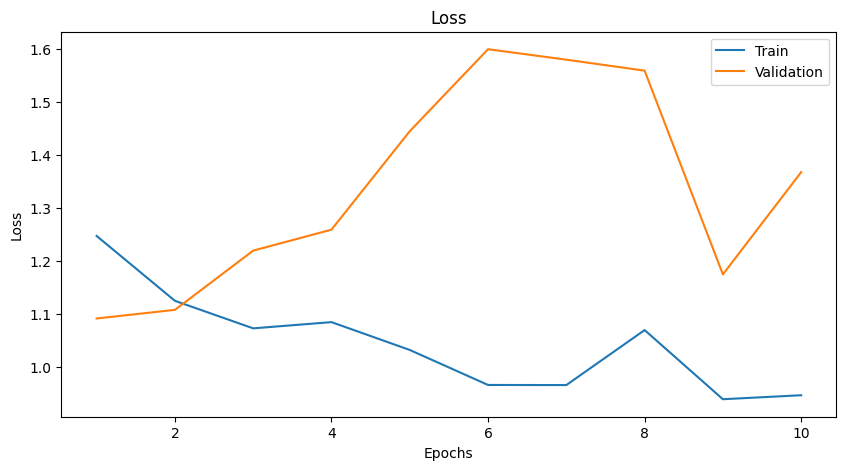

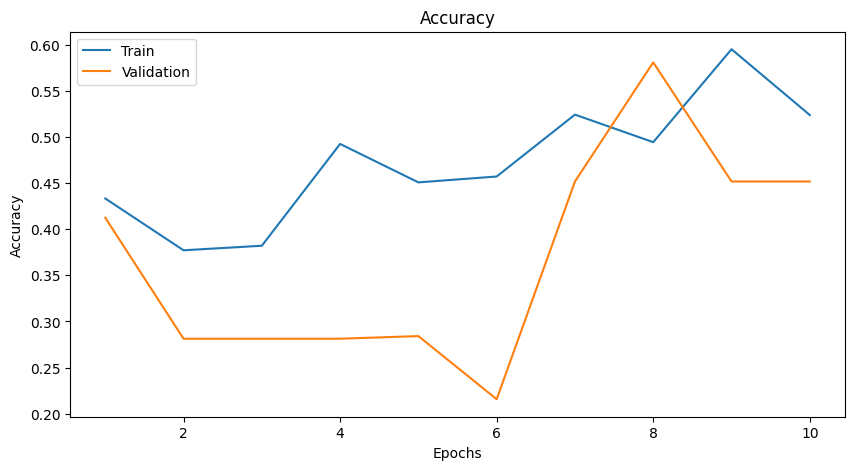

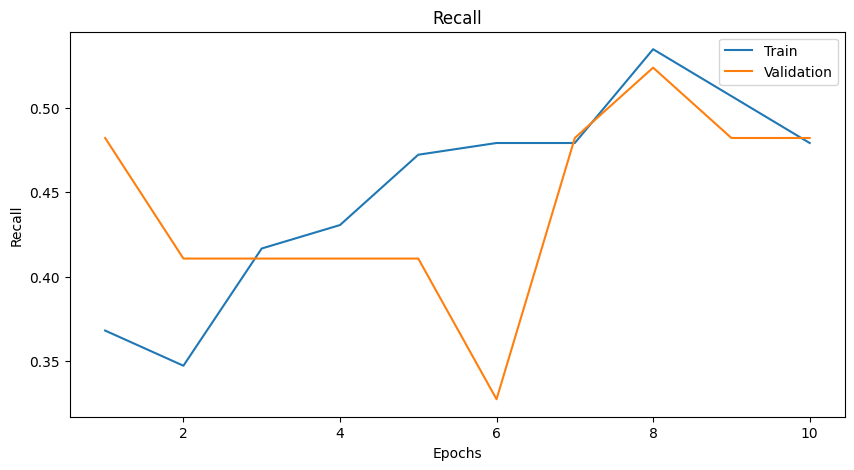

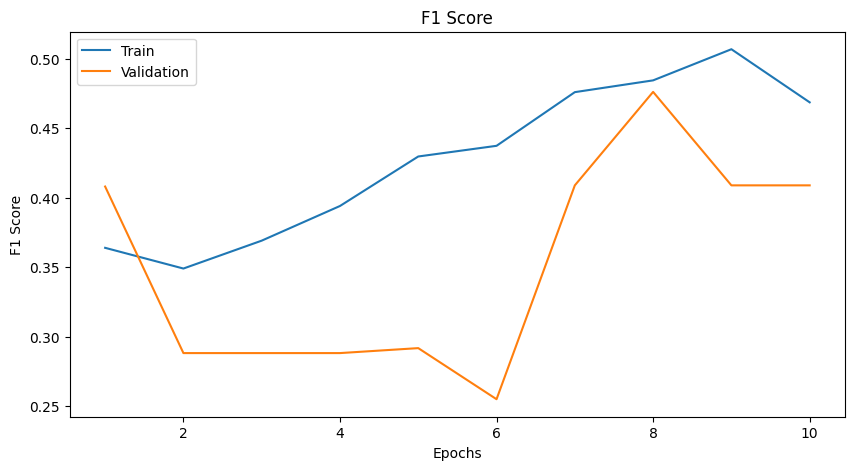

In [9]:
plot_metrics(train_losses, train_accuracies, train_recalls, train_f1_scores,  valid_losses, valid_accuracies, valid_recalls, valid_f1_scores)

In [10]:
sampler_val = torch.utils.data.SequentialSampler(ImageDataset(valid_dataset))
valid_loader = DataLoader(dataset_val, batch_size, sampler=sampler_val, drop_last=False, collate_fn=utils.collate_fn)
test_stats = evaluate(model, criterion, valid_loader, device, args.output_dir)

Test:  [0/3]  eta: 0:00:00  loss: 1.2518 (1.2518)  acc1: 25.0000 (25.0000)  f1: 0.1250 (0.1250)  precision: 0.0833 (0.0833)  recall: 0.2500 (0.2500)  time: 0.2833  data: 0.2276  max mem: 1104
Test:  [2/3]  eta: 0:00:00  loss: 1.3849 (1.4713)  acc1: 50.0000 (47.2222)  f1: 0.4250 (0.3685)  precision: 0.5000 (0.4147)  recall: 0.5000 (0.4722)  time: 0.2228  data: 0.1809  max mem: 1104
Test: Total time: 0:00:00 (0.2231 s / it)
Averaged stats: loss: 1.3849 (1.4713)  acc1: 50.0000 (47.2222)  f1: 0.4250 (0.3685)  precision: 0.5000 (0.4147)  recall: 0.5000 (0.4722)


/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/jupiter_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Species predicted by INTR is: Diarrhea
Species class  is: Diarrhea 



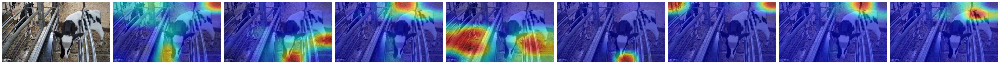

------------------------------ 

Test:  [ 0/19]  eta: 0:00:37    time: 1.9885  data: 0.0291  max mem: 1097
Species predicted by INTR is: Pneumonia
Species class  is: Diarrhea 



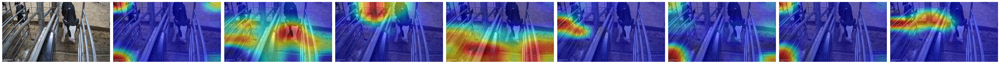

------------------------------ 

Test:  [ 1/19]  eta: 0:00:35    time: 1.9936  data: 0.0293  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Healthy 



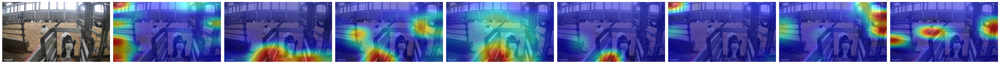

------------------------------ 

Test:  [ 2/19]  eta: 0:00:33    time: 1.9981  data: 0.0287  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Healthy 



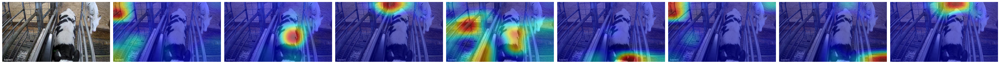

------------------------------ 

Test:  [ 3/19]  eta: 0:00:31    time: 1.9890  data: 0.0286  max mem: 1097
Species predicted by INTR is: Pneumonia
Species class  is: Pneumonia 



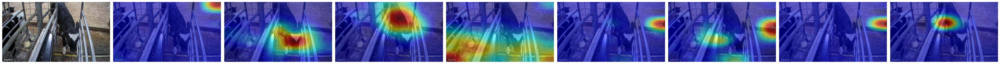

------------------------------ 

Test:  [ 4/19]  eta: 0:00:29    time: 1.9850  data: 0.0285  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Pneumonia 



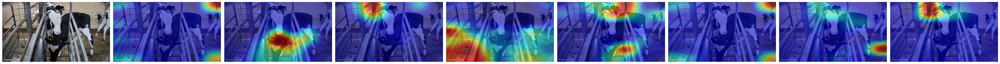

------------------------------ 

Test:  [ 5/19]  eta: 0:00:27    time: 1.9916  data: 0.0283  max mem: 1097
Species predicted by INTR is: Healthy
Species class  is: Diarrhea 



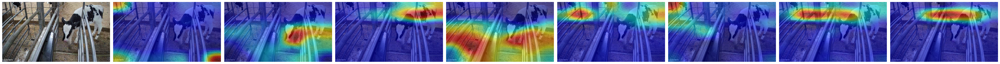

------------------------------ 

Test:  [ 6/19]  eta: 0:00:26    time: 2.0007  data: 0.0284  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Pneumonia 



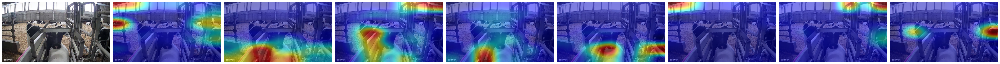

------------------------------ 

Test:  [ 7/19]  eta: 0:00:24    time: 2.0032  data: 0.0282  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Healthy 



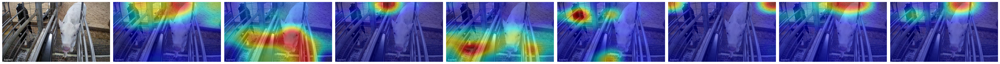

------------------------------ 

Test:  [ 8/19]  eta: 0:00:22    time: 2.0289  data: 0.0284  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Pneumonia 



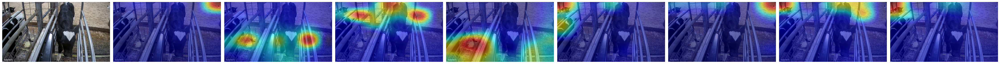

------------------------------ 

Test:  [ 9/19]  eta: 0:00:20    time: 2.0225  data: 0.0283  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Pneumonia 



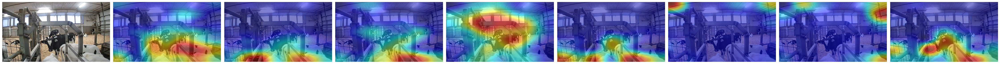

------------------------------ 

Test:  [10/19]  eta: 0:00:18    time: 2.0241  data: 0.0280  max mem: 1097
Species predicted by INTR is: Healthy
Species class  is: Healthy 



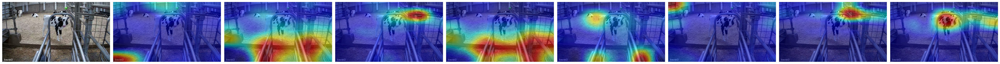

------------------------------ 

Test:  [11/19]  eta: 0:00:16    time: 2.0247  data: 0.0281  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Diarrhea 



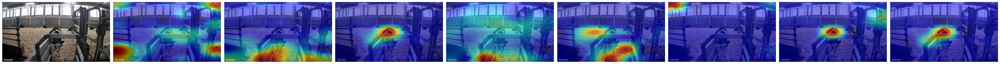

------------------------------ 

Test:  [12/19]  eta: 0:00:14    time: 2.0209  data: 0.0280  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Diarrhea 



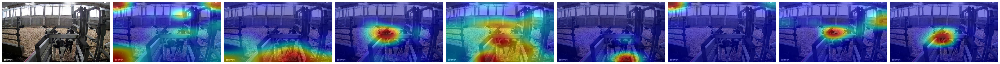

------------------------------ 

Test:  [13/19]  eta: 0:00:12    time: 2.0189  data: 0.0278  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Pneumonia 



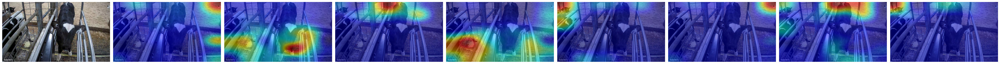

------------------------------ 

Test:  [14/19]  eta: 0:00:10    time: 2.0195  data: 0.0278  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Pneumonia 



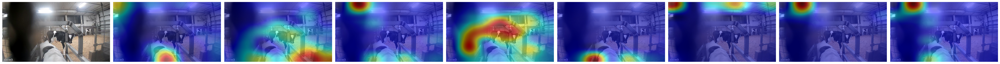

------------------------------ 

Test:  [15/19]  eta: 0:00:08    time: 2.0176  data: 0.0273  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Diarrhea 



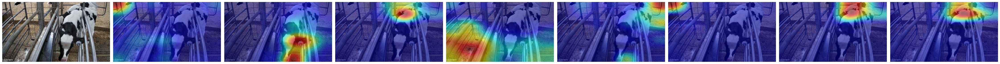

------------------------------ 

Test:  [16/19]  eta: 0:00:06    time: 2.0165  data: 0.0274  max mem: 1097
Species predicted by INTR is: Diarrhea
Species class  is: Diarrhea 



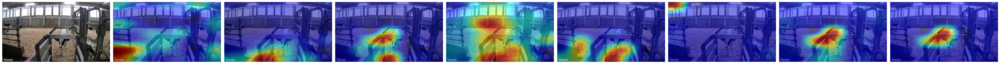

------------------------------ 

Test:  [17/19]  eta: 0:00:04    time: 2.0304  data: 0.0276  max mem: 1097
Species predicted by INTR is: Pneumonia
Species class  is: Diarrhea 



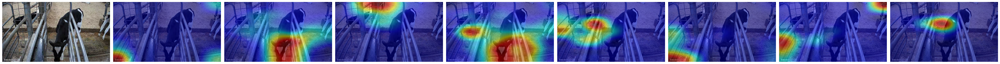

------------------------------ 

Test:  [18/19]  eta: 0:00:02    time: 2.0272  data: 0.0276  max mem: 1097
Test: Total time: 0:00:38 (2.0277 s / it)


In [20]:
parser = argparse.ArgumentParser('INTR interpretation visualization script', parents=[get_args_parser()])
args = parser.parse_args(args=[])

# model, _ = build_model(args)
# model.to(device)
# model = load_model(args, model)
model.eval()

valid_loader = DataLoader(ImageDataset(valid_dataset), batch_size=1, shuffle=False)
metric_logger = utils.MetricLogger(delimiter="  ")
header = 'Test:'
for samples, targets in metric_logger.log_every(valid_loader, 1, header):
    samples = samples.to(device)
    image_path = targets["file_name"][0][0]
    target_class = targets["image_label"][0][0]
    
    outputs, encoder_output, _, attention_scores, avg_attention_scores = model(samples)
    pred_class_index=predicted_class(outputs, topk=(1, 1))
    print ("Species predicted by INTR is:",get_class_name(int(pred_class_index[0][0])))
    print ("Species class  is:",get_class_name(int(target_class)), "\n")

    visualization(args, image_path, int(pred_class_index[0][0]), attention_scores, encoder_output)
    print("-" * 30, "\n")